# Masterarbeit FS24
## Evaluating the Effectiveness of CTA Trend Following Strategies: 
### A Comparative Analysis against State-of-the-Art MA-Crossing Strategies 
### by Raphael Nussbaumer

## 1. Import Libraries

In [4]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
from datetime import datetime
from datetime import date
from dateutil.relativedelta import relativedelta
from datetime import timedelta
import plotly.graph_objects as go

from scipy.stats import shapiro
import scipy.stats as stats
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

## 2. Data

In [5]:
Futures_Data = pd.read_excel('Futures_Data.xlsx')
Futures_Data.index = pd.to_datetime(Futures_Data.index)

Futures_orig = Futures_Data.set_index('Date')

new_headers = ['USD Future',
 'EUR Future (USD)',
 'JPY Future (USD)',
 'GBP Future (USD)',
 'GBP Future (EUR)',
 'CAD Future (USD)',
 'CHF Future (USD)',
 'S&P 500',
 'Nasdaq 100',
 'DJIA',
 'Russell 2000',
 'S&P 400',
 'S&P Canada 60',
 'FTSE 100',
 'DAX',
 'SMI',
 'CAC - 40',
 'IBEX 35',
 'MIB 30',
 'OMX',
 'DJ Stoxx 50',
 'SPI 200',
 'Nikkei 225',
 'Hang Seng Index',
 'US MSCI EAFE',
 'US 2-year',
 'US 5-year',
 'US 10-year',
 'US Ultra 10-year',
 'US 30-year',
 'Short Gilt (2 year)',
 'Medium Gilt (5 year)',
 'Long Gilt (10 year)',
 'Euro-Schatz-Futures (2 year)',
 'Euro-Bobl-Future (5 year)',
 'Euro-Bund-Future (10 year)',
 'Euro-Buxl-Future (30 year)',
 'Brent Crude Oil',
 'WTI Crude Oil',
 'Heating Oil',
 'RBOB Gasoline',
 'Natural Gas',
 'Gold',
 'Silver',
 'Platinum',
 'Palladium',
 'Copper',
 'Nickel',
 'Zinc',
 'Lean hogs',
 'Live cattle',
 'Feeder cattle',
 'Wheat',
 'Corn',
 'Oat',
 'Soybeans',
 'Soybean oil',
 'Frozen orange juice',
 'Cocoa',
 'Coffee',
 'Sugar No.11',
 'Cotton No.2'
]

# Set the new headers
Futures_orig.columns = new_headers

Futures_orig

,USD Future,EUR Future (USD),JPY Future (USD),GBP Future (USD),GBP Future (EUR),CAD Future (USD),CHF Future (USD),S&P 500,Nasdaq 100,DJIA,...,Wheat,Corn,Oat,Soybeans,Soybean oil,Frozen orange juice,Cocoa,Coffee,Sugar No.11,Cotton No.2
Date,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-04,96.398,1.44314,157.312,153.46,NaN,0.646,115.328,1405.44,NaN,NaN,...,93.92159,19.15196,2.16665,2.94494,0.47548,1.93386,4011.0,29.62163,0.12271,3.47810
1999-01-05,96.449,1.43755,158.465,153.27,NaN,0.651,115.015,1419.31,NaN,NaN,...,94.34238,19.37492,2.19184,2.97325,0.48036,1.97721,4037.0,28.75183,0.13112,3.54881
1999-01-06,97.669,1.41590,155.846,153.27,NaN,0.653,112.996,1449.89,NaN,NaN,...,96.78300,19.95461,2.26239,2.99078,0.48483,1.92255,4026.0,28.38941,0.13187,3.53349
1999-01-07,96.801,1.42891,158.709,152.94,NaN,0.652,114.405,1447.06,NaN,NaN,...,96.78300,19.59788,2.22712,2.95842,0.48199,1.88296,4026.0,28.66727,0.13202,3.46691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-12-26,101.104,1.10840,71.135,127.30,0.87070,0.759,118.205,4825.00,17083.50,37894.0,...,6.36250,4.80250,3.68250,13.19000,0.48510,3.26350,4283.0,1.94350,0.20530,0.80050
2023-12-27,100.654,1.11385,71.420,128.00,0.87020,0.758,119.600,4833.50,17113.25,38006.0,...,6.23000,4.76500,3.73250,13.20500,0.48660,3.25600,4280.0,1.97750,0.20600,0.80530


### 2.1 Data Description

In [6]:
Futures_orig.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 6521 entries, 1999-01-01 to 2023-12-29
Data columns (total 62 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   USD Future                    6446 non-null   float64
 1   EUR Future (USD)              6342 non-null   float64
 2   JPY Future (USD)              6343 non-null   float64
 3   GBP Future (USD)              6343 non-null   float64
 4   GBP Future (EUR)              6050 non-null   float64
 5   CAD Future (USD)              6342 non-null   float64
 6   CHF Future (USD)              6345 non-null   float64
 7   S&P 500                       6340 non-null   float64
 8   Nasdaq 100                    6226 non-null   float64
 9   DJIA                          5484 non-null   float64
 10  Russell 2000                  1633 non-null   float64
 11  S&P 400                       5547 non-null   float64
 12  S&P Canada 60                 6107 non-null 

In [7]:
Futures_orig.describe()

,USD Future,EUR Future (USD),JPY Future (USD),GBP Future (USD),GBP Future (EUR),CAD Future (USD),CHF Future (USD),S&P 500,Nasdaq 100,DJIA,...,Wheat,Corn,Oat,Soybeans,Soybean oil,Frozen orange juice,Cocoa,Coffee,Sugar No.11,Cotton No.2
count,6446.000000,6342.000000,6343.000000,6343.000000,6050.000000,6342.000000,6345.000000,6340.000000,6226.000000,5484.000000,...,6298.000000,6297.000000,6298.000000,6296.000000,6299.000000,6315.000000,6271.000000,6270.000000,6270.000000,6309.000000
mean,92.352662,1.365555,119.767115,156.222932,0.879098,0.813842,115.315977,1975.638863,5066.023518,17312.395881,...,28.505759,6.873685,3.009682,5.963804,0.338447,1.447795,3074.741030,5.425810,0.214540,1.130652
std,12.856225,0.205537,21.178401,23.028406,0.069735,0.115822,14.324638,1118.152745,4315.944208,9269.738989,...,19.892358,3.630506,1.023585,2.996857,0.118826,0.454977,682.314146,5.211750,0.090641,0.675171
min,72.249000,0.967680,67.310000,107.610000,0.749890,0.605000,79.487000,618.060000,1005.090000,5608.210000,...,5.610000,2.035280,1.279350,1.858690,0.147050,0.665410,1434.000000,1.044610,0.069590,0.390200
25%,82.774250,1.211080,103.997000,135.690000,0.811760,0.745000,107.990000,1179.110000,1935.532500,9756.257500,...,9.719905,4.374680,2.178068,3.212427,0.239830,1.108480,2598.000000,2.200015,0.151930,0.758490
50%,90.308500,1.336260,118.937000,153.900000,0.883755,0.794000,115.446000,1449.085000,3066.910000,13125.990000,...,24.412540,6.035560,2.802790,5.807535,0.320440,1.432480,2945.000000,4.467575,0.197170,0.907400
75%,98.711000,1.540402,134.561500,171.480000,0.938488,0.916000,123.663000,2578.885000,6705.342500,25092.237500,...,43.393873,8.457120,3.716982,7.723365,0.415310,1.680555,3629.000000,5.875788,0.254560,1.228830
max,129.235000,1.848930,165.729000,214.970000,1.093390,1.068000,176.237000,5044.920000,17733.950000,38282.710000,...,98.045380,20.241920,6.575930,15.340060,0.773210,4.258000,4953.000000,31.145250,0.533340,3.867300


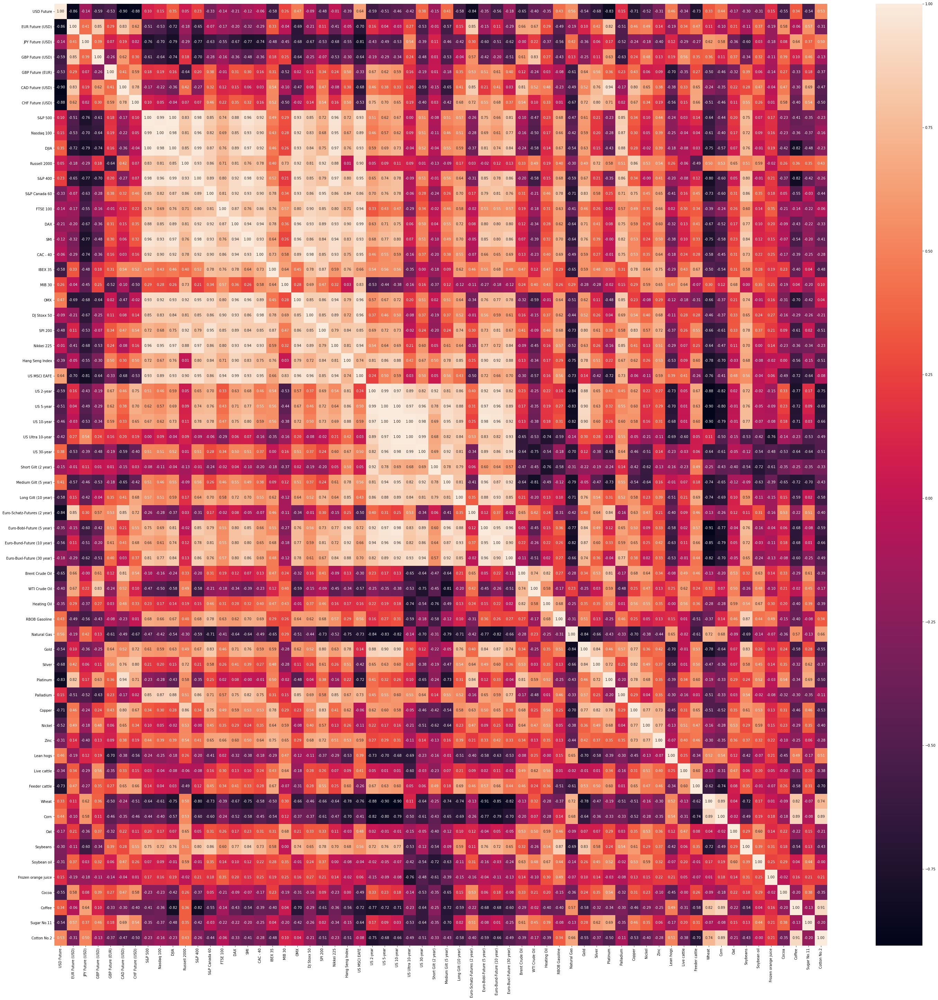

In [8]:
corr_matrix = Futures_orig.corr()
plt.figure(figsize=(50, 50))
sns.heatmap(corr_matrix, annot=True, fmt=".2f")
plt.show()

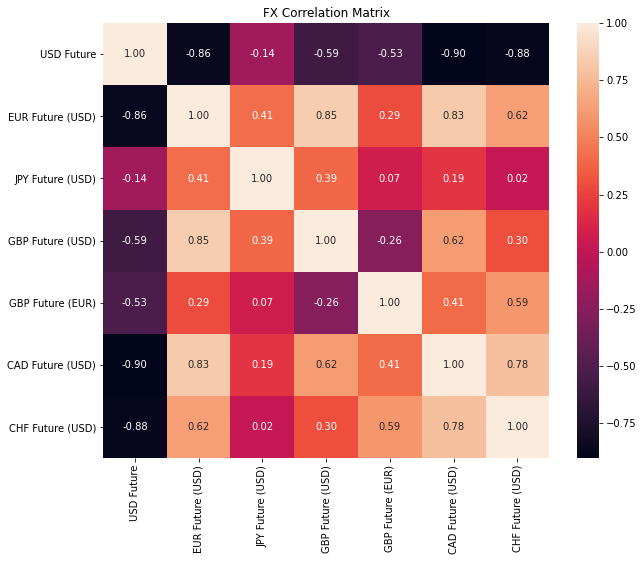

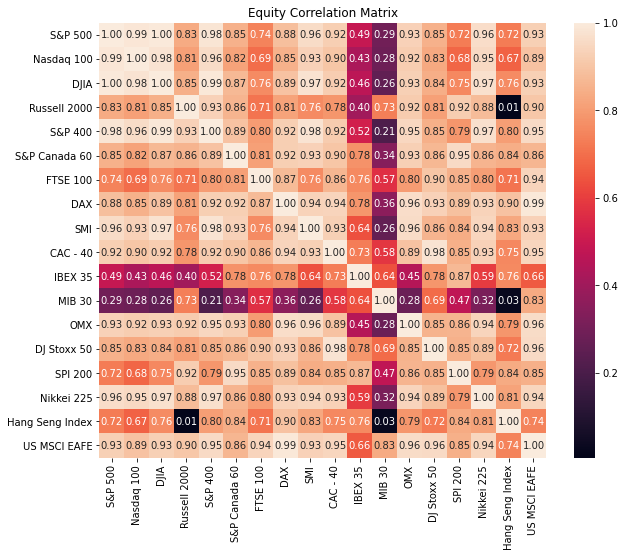

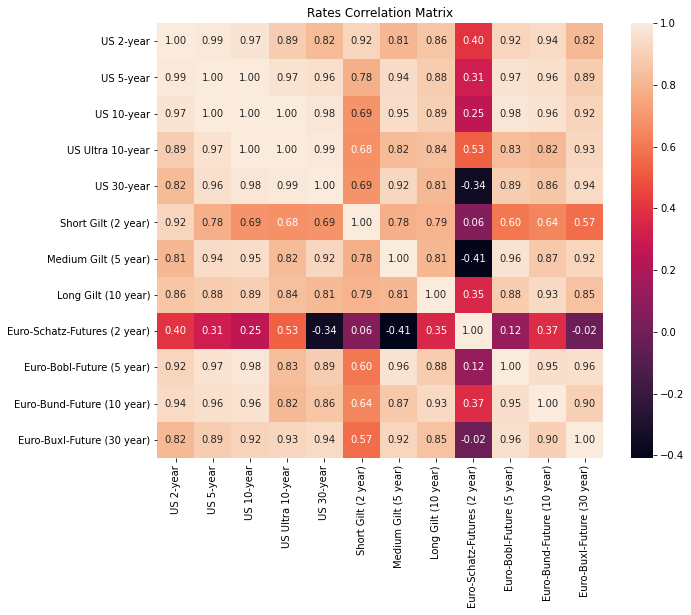

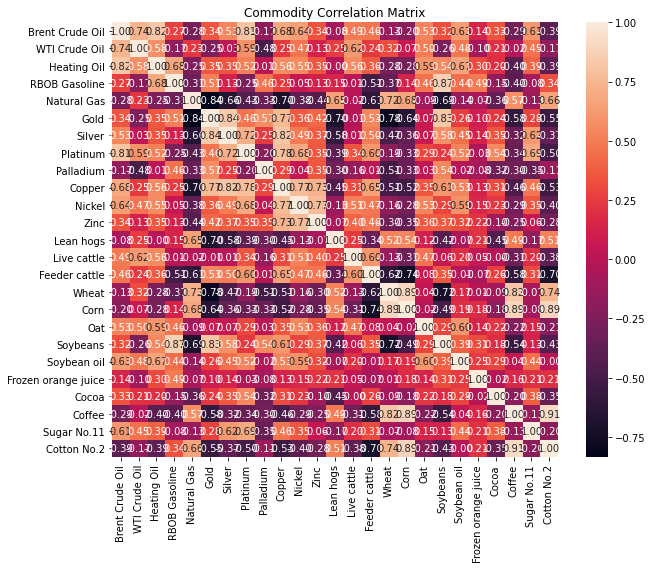

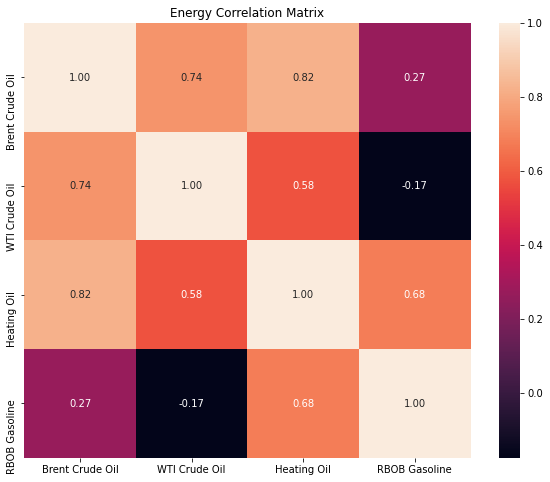

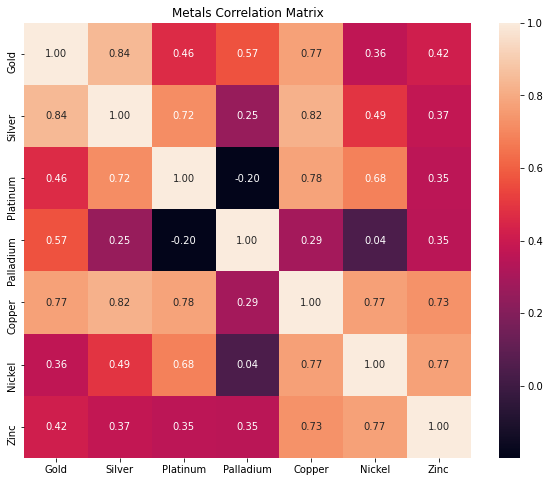

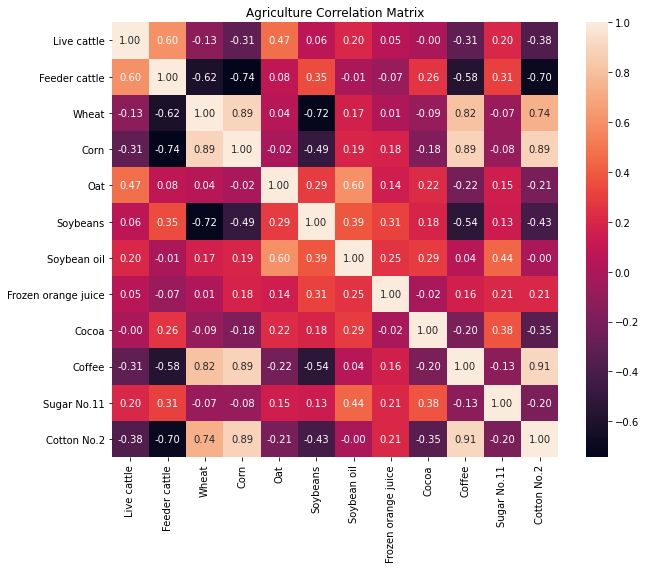

In [9]:
# Define the slices for each DataFrame as a dictionary
slices = {
    'FX': (0, 7),
    'Equity': (7, 25),
    'Rates': (25, 37),
    'Commodity': (37, 62),
    'Energy': (37, 41),
    'Metals': (42, 49),
    'Agriculture': (50, 62),
}

# Loop through the slices dictionary
for name, (start_col, end_col) in slices.items():
    # Create each DataFrame by slicing the original DataFrame
    temp_df = Futures_orig.iloc[:, start_col:end_col]
    
    # Calculate the correlation matrix for the current DataFrame
    corr_matrix = temp_df.corr()
    
    # Plot the heatmap for the correlation matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=True, fmt=".2f")
    plt.title(f'{name} Correlation Matrix')
    plt.show()

#### Making own DataFrames to delete the NA's

In [10]:
# Dictionary to hold the new DataFrames, one for each column
dfs = {}

for column in Futures_orig.columns:
    # Create a new DataFrame for each column using the same index
    dfs[column] = pd.DataFrame(Futures_orig[column])

# Initialize a dictionary to store the beginning dates
beginning_dates_dict = {}
    
for header in new_headers:
    # Check if the DataFrame for the current header exists in the dfs dictionary
    if header in dfs:
        print(f"{header}:")
        
        beginning_date = dfs[header].apply(lambda col: col.first_valid_index()).iloc[0]
        beginning_dates_dict[header] = beginning_date
        print(f'Beginning date for: {beginning_date}')
        
        print(dfs[header].isnull().sum())
        num_rows_before = len(dfs[header].index)
        print(f'Number of rows for {header} before dropping NAs: {num_rows_before}')
        
        dfs[header].dropna(inplace=True)
        
        print(dfs[header].isnull().sum())
        num_rows_after = len(dfs[header].index)
        print(f'Number of rows for {header} after dropping NAs: {num_rows_after}')
        print("-" * 40)  # Just for visual separation between outputs
    else:
        print(f"The key '{header}' does not exist in the dfs dictionary.")
        
        
# Convert the beginning dates dictionary to a DataFrame
beginning_dates_df = pd.DataFrame(list(beginning_dates_dict.items()), columns=['Header', 'Beginning Date'])

USD Future:
Beginning date for: 1999-01-04 00:00:00
USD Future    75
dtype: int64
Number of rows for USD Future before dropping NAs: 6521
USD Future    0
dtype: int64
Number of rows for USD Future after dropping NAs: 6446
----------------------------------------
EUR Future (USD):
Beginning date for: 1999-01-04 00:00:00
EUR Future (USD)    179
dtype: int64
Number of rows for EUR Future (USD) before dropping NAs: 6521
EUR Future (USD)    0
dtype: int64
Number of rows for EUR Future (USD) after dropping NAs: 6342
----------------------------------------
JPY Future (USD):
Beginning date for: 1999-01-04 00:00:00
JPY Future (USD)    178
dtype: int64
Number of rows for JPY Future (USD) before dropping NAs: 6521
JPY Future (USD)    0
dtype: int64
Number of rows for JPY Future (USD) after dropping NAs: 6343
----------------------------------------
GBP Future (USD):
Beginning date for: 1999-01-04 00:00:00
GBP Future (USD)    178
dtype: int64
Number of rows for GBP Future (USD) before dropping NA

Beginning date for: 2009-11-24 00:00:00
Medium Gilt (5 year)    2888
dtype: int64
Number of rows for Medium Gilt (5 year) before dropping NAs: 6521
Medium Gilt (5 year)    0
dtype: int64
Number of rows for Medium Gilt (5 year) after dropping NAs: 3633
----------------------------------------
Long Gilt (10 year):
Beginning date for: 1999-01-04 00:00:00
Long Gilt (10 year)    111
dtype: int64
Number of rows for Long Gilt (10 year) before dropping NAs: 6521
Long Gilt (10 year)    0
dtype: int64
Number of rows for Long Gilt (10 year) after dropping NAs: 6410
----------------------------------------
Euro-Schatz-Futures (2 year):
Beginning date for: 1999-01-04 00:00:00
Euro-Schatz-Futures (2 year)    149
dtype: int64
Number of rows for Euro-Schatz-Futures (2 year) before dropping NAs: 6521
Euro-Schatz-Futures (2 year)    0
dtype: int64
Number of rows for Euro-Schatz-Futures (2 year) after dropping NAs: 6372
----------------------------------------
Euro-Bobl-Future (5 year):
Beginning date fo

#### Calculate the daily returns, annualized return and the annulized volatility

In [11]:
# Initialize a DataFrame to store the annualized metrics
annualized_metrics_df = pd.DataFrame(columns=['Header', 'Annualized Mean Return', 'Annualized Volatility'])

for header in new_headers:
    if header in dfs:
        # Calculate daily returns
        dfs[header]['Daily Returns'] = dfs[header][header].pct_change()
        
        # Calculate annualized mean return and volatility
        daily_mean_return = dfs[header]['Daily Returns'].mean()
        annualized_mean_return = daily_mean_return * 252  # 252 trading days
        daily_volatility = dfs[header]['Daily Returns'].std()
        annualized_volatility = daily_volatility * np.sqrt(252)
        
        # Append the metrics to the annualized_metrics_df DataFrame
        annualized_metrics_df = annualized_metrics_df.append({'Header': header,
                                                               'Annualized Mean Return': annualized_mean_return,
                                                               'Annualized Volatility': annualized_volatility},
                                                              ignore_index=True)
        
        print(f"{header} - Annualized Mean Return: {annualized_mean_return}, Annualized Volatility: {annualized_volatility}")
        print("-" * 40)  # Visual separation between outputs
    else:
        print(f"The key '{header}' does not exist in the dfs dictionary.")
        
annualized_metrics_df.set_index('Header', inplace = True)
annualized_metrics_to_use = annualized_metrics_df.T

<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e8

USD Future - Annualized Mean Return: 0.004902319269390237, Annualized Volatility: 0.0783311776469075
----------------------------------------
EUR Future (USD) - Annualized Mean Return: -0.00612446189813836, Annualized Volatility: 0.0937664287229814
----------------------------------------
JPY Future (USD) - Annualized Mean Return: -0.026215537058408223, Annualized Volatility: 0.0997694972398951
----------------------------------------
GBP Future (USD) - Annualized Mean Return: -0.0030114685460629663, Annualized Volatility: 0.09315067631896236
----------------------------------------
GBP Future (EUR) - Annualized Mean Return: 0.002200077677752781, Annualized Volatility: 0.07994569864136654
----------------------------------------
CAD Future (USD) - Annualized Mean Return: 0.009881373383620131, Annualized Volatility: 0.08523757337841731
----------------------------------------
CHF Future (USD) - Annualized Mean Return: 0.00705910121691474, Annualized Volatility: 0.10584072243823256
-----

<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e892>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  annualized_metrics_df = annualized_metrics_df.append({'Header': header,
<ipython-input-11-bb907d81e8

#### Create a Summary for the statistics

In [12]:
Summary_statistics = Futures_orig.describe()

beginning_dates_orig = beginning_dates_df.set_index('Header')
beginning_dates_transposed = beginning_dates_orig.T
Summary_statistics_appended = pd.concat([Summary_statistics, beginning_dates_transposed, annualized_metrics_to_use])

Summary_statistics_appended_dropped = Summary_statistics_appended.drop(['mean', 'std', '25%', '50%', '75%'])

#Summary_statistics_for_Thesis = Summary_statistics_appended_dropped.T
#Summary_statistics_for_Thesis.to_excel('Summary_statistics.xlsx')

### 2.2 Data visualisation

In [13]:
import plotly.graph_objects as go

# Assuming Futures_orig is your DataFrame and it's already loaded

# List of features to plot
features = new_headers

# Loop through each feature and create a separate plot
for feature in features:
    # Creating the trace for the current feature
    trace = go.Scatter(x=Futures_orig.index, y=Futures_orig[feature], mode='lines', name='Closing Price')
    
    # Creating the data list with the current trace
    data = [trace]
    
    # Creating the layout for the current plot, dynamically setting the title to the current feature
    layout = go.Layout(title=f'{feature} over Time', xaxis=dict(title='Days'), yaxis=dict(title=f'{feature} Price'))
    
    # Creating the figure with the current data and layout
    fig = go.Figure(data=data, layout=layout)
    
    # Displaying the figure
    fig.show()

## 3. Constructing the different Trend following Methods

### 1. Moving averages

In [14]:
# Window sizes for the moving averages
short_MA = 10
long_MA = 40

# Iterate over the headers and apply the moving averages
for header in new_headers:
    # Make sure the DataFrame exists in your dictionary
    if header in dfs:
        # Calculate the short-window moving average and add it as a new column
        dfs[header][f'MA_{short_MA}'] = dfs[header][header].rolling(window=short_MA).mean()

        # Calculate the long-window moving average and add it as a new column
        dfs[header][f'MA_{long_MA}'] = dfs[header][header].rolling(window=long_MA).mean()
    else:
        print(f"DataFrame for {header} not found in dfs.")

#### Plot each MA strategy on its own

In [15]:
import plotly.graph_objs as go

Future_to_plot = 'Zinc'

# Original line for the closing price
trace_price = go.Scatter(
    x=dfs[Future_to_plot].index, 
    y=dfs[Future_to_plot][Future_to_plot], 
    mode='lines', 
    name='Closing Price'
)

# Line for the 10-day moving average
trace_MA_10 = go.Scatter(
    x=dfs[Future_to_plot].index, 
    y=dfs[Future_to_plot][f'MA_{short_MA}'], 
    mode='lines', 
    name=f'{short_MA}-day MA'
)

# Line for the 40-day moving average
trace_MA_40 = go.Scatter(
    x=dfs[Future_to_plot].index, 
    y=dfs[Future_to_plot][f'MA_{long_MA}'], 
    mode='lines', 
    name=f'{long_MA}-day MA'
)

# Combine all traces
data = [trace_price, trace_MA_10, trace_MA_40]

# Define layout
layout = go.Layout(
    title= str(Future_to_plot)+' over Time', 
    xaxis=dict(title='Days'), 
    yaxis=dict(title=str(Future_to_plot)+' Price')
)

# Create figure and add data and layout
fig = go.Figure(data=data, layout=layout)

# Show the figure
fig.show()